Spectral Clustering Example.

The image loaded here is a cropped portion of the ``MERCATOR_LC80210392016114LGN00_B10.TIF`` LANDSAT image included as a public [datashader example](http://datashader.org/topics/landsat.html).

In addition to `dask-ml`, we'll use `rasterio` to read the data and `matplotlib` to plot the figures.
I'm just working on my laptop, so we could use either the threaded or distributed scheduler. I'll use the distributed scheduler for the diagnostics.


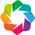

In [1]:
import rasterio
import holoviews as hv
import dask.array as da
from dask_ml.cluster import SpectralClustering
from dask.distributed import Client
hv.extension('bokeh')

In [2]:
# read geotiff as an chunked xarray
import xarray as xr
# FIXME: the landsat-sample.tiff example image is a 2 band image and not the 
#   standard 3 to 5.  Use another one for the moment.
arr = xr.open_rasterio('Midwest_Mosaic.tif', chunks={'band': 1, 'x': 256, 'y': 256}).T
print(arr.shape)
print(arr)
arr = arr.astype(float)
# Rescale for the clustering algorithm
arr = (arr - arr.mean()) / arr.std()

(1343, 1227, 3)
<xarray.DataArray (x: 1343, y: 1227, band: 3)>
dask.array<shape=(1343, 1227, 3), dtype=uint8, chunksize=(256, 256, 1)>
Coordinates:
  * band     (band) int64 1 2 3
  * y        (y) float64 4.986e+06 4.985e+06 4.985e+06 4.984e+06 4.984e+06 ...
  * x        (x) float64 1.939e+05 1.944e+05 1.948e+05 1.953e+05 1.957e+05 ...
Attributes:
    transform:   (193671.75, 456.0, 0.0, 4986075.0, 0.0, -456.0)
    crs:         +init=epsg:32615
    res:         (456.0, 456.0)
    is_tiled:    0
    nodatavals:  (nan, nan, nan)


/home/jldavid3/anaconda3/envs/pangeo/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: The value of this property will change in version 1.0. Please see https://github.com/mapbox/rasterio/issues/86 for details.
  This is separate from the ipykernel package so we can avoid doing imports until


In [5]:
# not working...
#%%opts Image (cmap='viridis')
hv.Image(arr[:,:,0].compute())

:Image   [y,x]   (z)

In [6]:
client = Client(processes=False)
client

Client Scheduler: inproc://128.183.105.76/22706/1 Dashboard: http://localhost:36406/status,Cluster Workers: 1 Cores: 8 Memory: 33.69 GB


We'll reshape the image to be how dask-ml / scikit-learn expect it: `(n_samples, n_features)` where n_features is 1 in this case. Then we'll persist that in memory. We still have a small dataset at this point. The large dataset, which dask helps us manage, is the intermediate `n_samples x n_samples` array that spectral clustering operates on. For our 2,500 x 2,500 pixel subset, that's ~50

In [7]:
#X = da.from_array(arr.reshape(-1, 1), chunks=100_000)

X = arr.stack(z=('x', 'y')).dropna(dim='z').reset_index('z').T #.expand_dims(dim='e',axis=1)

print(X.shape)
print (X)
#X = client.compute(X)

(1647861, 3)
<xarray.DataArray (z: 1647861, band: 3)>
dask.array<shape=(1647861, 3), dtype=float64, chunksize=(62577, 1)>
Coordinates:
  * band     (band) int64 1 2 3
    x        (z) float64 1.939e+05 1.939e+05 1.939e+05 1.939e+05 1.939e+05 ...
    y        (z) float64 4.986e+06 4.985e+06 4.985e+06 4.984e+06 4.984e+06 ...
Dimensions without coordinates: z


And we'll fit the estimator.

In [8]:
clf = SpectralClustering(n_clusters=4, random_state=0,
                         kmeans_params={'init_max_iter': 5})

In [9]:
%time clf.fit(X)

INFO:dask_ml.cluster.spectral:k-means for assign_labels[starting]
INFO:dask_ml.cluster.k_means:Finished check_array in 0.86 s
INFO:dask_ml.cluster.k_means:Initializing with k-means||
INFO:dask_ml.cluster.k_means:init iteration  1/ 5 0.95 s,  4 centers
INFO:dask_ml.cluster.k_means:init iteration  2/ 5 1.04 s,  6 centers
INFO:dask_ml.cluster.k_means:init iteration  3/ 5 1.11 s,  8 centers
INFO:dask_ml.cluster.k_means:init iteration  4/ 5 1.13 s, 10 centers
INFO:dask_ml.cluster.k_means:init iteration  5/ 5 1.17 s, 11 centers
INFO:dask_ml.cluster.k_means:Finished initialization. 11.46 s,  4 centers
INFO:dask_ml.cluster.k_means:Lloyd loop  0. Shift: 0.1090 [1.03 s]
INFO:dask_ml.cluster.k_means:Lloyd loop  1. Shift: 0.0061 [1.04 s]
INFO:dask_ml.cluster.k_means:Lloyd loop  2. Shift: 0.0009 [1.01 s]
INFO:dask_ml.cluster.k_means:Lloyd loop  3. Shift: 0.0002 [1.01 s]
INFO:dask_ml.cluster.k_means:Lloyd loop  4. Shift: 0.0000 [1.01 s]
INFO:dask_ml.cluster.spectral:k-means for assign_labels[finishe

CPU times: user 35.6 s, sys: 16.4 s, total: 52.1 s
Wall time: 36.1 s


SpectralClustering(affinity='rbf', assign_labels='kmeans', coef0=1, degree=3,
          eigen_solver=None, eigen_tol=0.0, gamma=1.0, kernel_params=None,
          kmeans_params={'init_max_iter': 5}, n_clusters=4,
          n_components=100, n_init=10, n_jobs=1, n_neighbors=10,
          persist_embedding=False, random_state=0)

In [12]:
labels = clf.assign_labels_.labels_.compute()
print(labels.shape)
c = labels.reshape(arr[:,:,0].shape)
print(c.shape)

(1647861,)
(1343, 1227)


In [15]:
%%opts Image (cmap='viridis')
hv.Image(arr[:,:,0]).relabel('Image') + hv.Image(c).relabel('Clustered')

/home/jldavid3/anaconda3/envs/pangeo/lib/python3.6/site-packages/bokeh/core/json_encoder.py:80: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  elif np.issubdtype(type(obj), np.float):


:Layout
   .Image.Image     :Image   [y,x]   (z)
   .Image.Clustered :Image   [x,y]   (z)